# Moran process

In [2]:
using StatsBase: mean
using Plots

In [28]:
@enum Strategy C D

mutable struct Model
    N::Int
    μ::Float64
    t_max::Int
    strategy_vec::Vector{Strategy}

    Model(; N::Int = 100, μ::Float64 = 0.001, t_max = 10_000) = new(N, μ, t_max, fill(D, N))
end

function mutation!(model::Model)::Nothing
    id = rand(1:model.N)
    model.strategy_vec[id] = rand() > model.μ ? model.strategy_vec[id] : rand([C, D])
    return
end

function run!(model::Model)::Vector{Float64}
    C_rate_vec = fill(0.0, model.t_max)

    for t in 1:model.t_max
        mutation!(model::Model)
        C_rate_vec[t] = calc_C_rate(model)
    end

    return C_rate_vec
end

calc_C_rate(model::Model)::Float64 = mean(model.strategy_vec .== C);

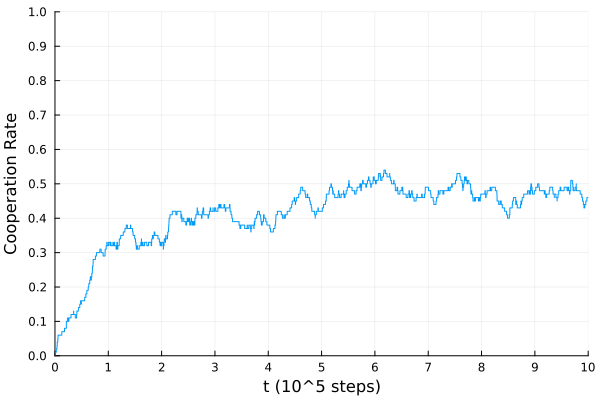

In [30]:
model = Model(t_max = 1_000_000)
C_rate_vec = run!(model)
plot(
    C_rate_vec,
    label=false,
    xlim=(1, model.t_max), xticks=(0:Int(model.t_max / 10):model.t_max, 0:10), xlabel="t (10^5 steps)",
    ylim=(0, 1), yticks=0:0.1:1, ylabel="Cooperation Rate",
)